![](https://data-flair.training/blogs/wp-content/uploads/sites/2/2018/02/File-Handling-In-python-01.jpg)

# Read all the files available in this kernel:

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/prostate-cancer-grade-assessment/sample_submission.csv
/kaggle/input/prostate-cancer-grade-assessment/test.csv
/kaggle/input/prostate-cancer-grade-assessment/train.csv
/kaggle/input/prostate-cancer-grade-assessment/train_images/a05ded7fe107cfdfcfc8f644fb2d7313.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/72e64850d127c65815492af84473a26e.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/274187a867ebf7834ab44372da776439.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/a08e24cff451d628df797efc4343e13c.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/b7540ad7f233e9c19a6cb083945072fd.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/3bc54012b4306e04b9b157811d18c1f6.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/b0327dd5245060b4f79ab8a05e114b20.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/2c654377bd25b4e7ba71f32ddac3045e.tiff
/kaggle/input/prostate-cancer-grad

## If you want to know when the files were last modified:

In [2]:
from datetime import datetime
from os import scandir

def convert_date(timestamp):
    d = datetime.utcfromtimestamp(timestamp)
    formated_date = d.strftime('%d %b %Y')
    return formated_date

def get_files():
    dir_entries = scandir('my_directory/')
    for entry in dir_entries:
        if entry.is_file():
            info = entry.stat()
            print(f'{entry.name}\t Last Modified: {convert_date(info.st_mtime)}')


![](https://www.freecodecamp.org/news/content/images/2020/05/Python-File-Handling-1.png)

# 1. txt File:

In [3]:
with open('data.txt', 'r') as f:
    data = f.read()

FileNotFoundError: [Errno 2] No such file or directory: 'data.txt'

# 2. csv File:

In [4]:
import pandas as pd

df_csv=pd.read_csv('/kaggle/input/titanic/train.csv')
df_csv.head(2)

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C


# 3. xlsx File: 

In [5]:
from pandas import read_excel
# find your sheet name at the bottom left of your excel file and assign 
# it to my_sheet 
my_sheet = 'Sheet1' # change it to your sheet name
file_name = 'products_and_categories.xlsx' # change it to the name of your excel file
df = read_excel(file_name, sheet_name = my_sheet)
print(df.head()) # shows headers with top 5 rows

FileNotFoundError: [Errno 2] No such file or directory: 'products_and_categories.xlsx'

# 4. sqlite File (.db)

In [6]:
import sqlite3 
  
# connecting to the database  
connection = sqlite3.connect("myTable.db") 

# 5. image Files (jpeg, jpg, png, etc..):

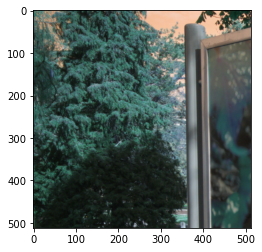

In [7]:
import matplotlib.pyplot as plt
import cv2 
  
# Save image in set directory 
# Read RGB image 
img = cv2.imread('../input/alaska2-image-steganalysis/Cover/00001.jpg')
# Output img 
plt.imshow(img)
plt.show()

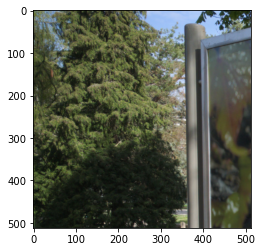

In [8]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img=mpimg.imread('../input/alaska2-image-steganalysis/Cover/00001.jpg') # read
# To plot the image
imgplot = plt.imshow(img)

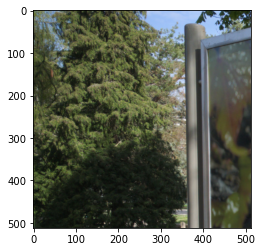

In [9]:
from PIL import Image
image = Image.open("../input/alaska2-image-steganalysis/Cover/00001.jpg")
#image.show()
plt.imshow(image)

# 6.tiff File: 

this piece of code is taken from https://www.kaggle.com/rohitsingh9990/panda-eda-better-visualization-simple-baseline/notebook

In [10]:
# There are two ways to load the data from the PANDA dataset:
# Option 1: Load images using openslide
import openslide
# Option 2: Load images using skimage (requires that tifffile is installed)
import skimage.io
import random
import seaborn as sns
import cv2

# General packages
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import PIL
import os

In [11]:
BASE_PATH = '../input/prostate-cancer-grade-assessment'

# image and mask directories
data_dir = f'{BASE_PATH}/train_images'
mask_dir = f'{BASE_PATH}/train_label_masks'


# Location of training labels
train = pd.read_csv(f'{BASE_PATH}/train.csv').set_index('image_id')
test = pd.read_csv(f'{BASE_PATH}/test.csv')

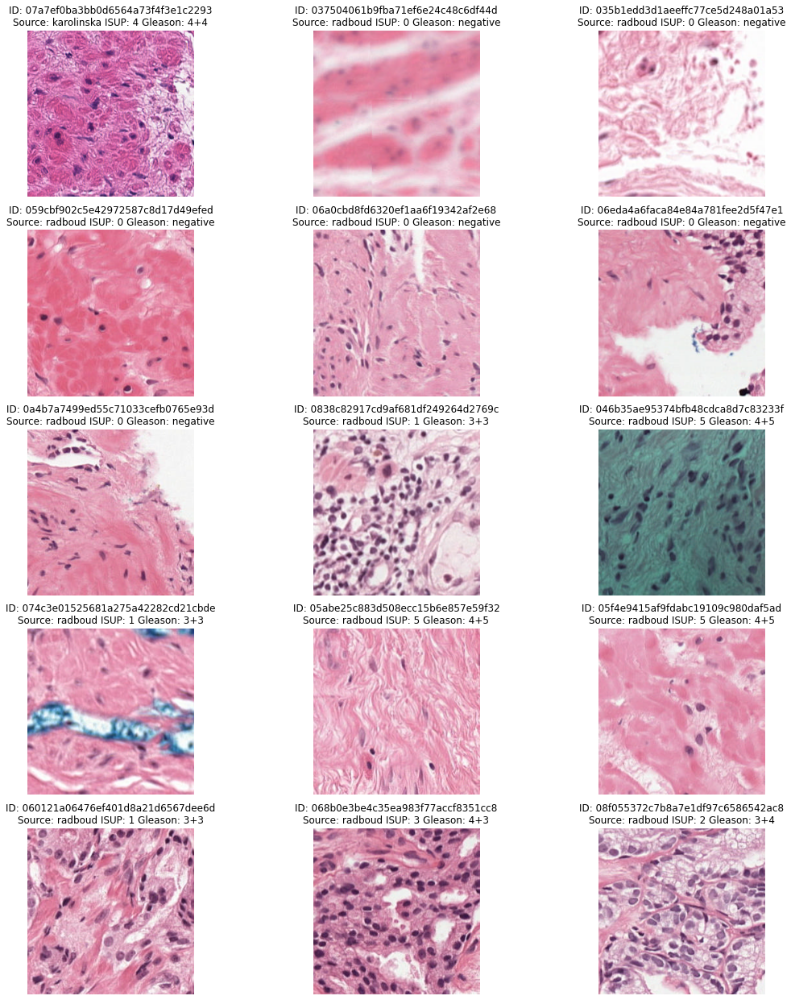

In [12]:
def display_images(slides): 
    f, ax = plt.subplots(5,3, figsize=(18,22))
    for i, slide in enumerate(slides):
        image = openslide.OpenSlide(os.path.join(data_dir, f'{slide}.tiff'))
        spacing = 1 / (float(image.properties['tiff.XResolution']) / 10000)
        patch = image.read_region((1780,1950), 0, (256, 256))
        ax[i//3, i%3].imshow(patch) 
        image.close()       
        ax[i//3, i%3].axis('off')
        
        image_id = slide
        data_provider = train.loc[slide, 'data_provider']
        isup_grade = train.loc[slide, 'isup_grade']
        gleason_score = train.loc[slide, 'gleason_score']
        ax[i//3, i%3].set_title(f"ID: {image_id}\nSource: {data_provider} ISUP: {isup_grade} Gleason: {gleason_score}")

    plt.show() 
    
images = [
    '07a7ef0ba3bb0d6564a73f4f3e1c2293',
    '037504061b9fba71ef6e24c48c6df44d',
    '035b1edd3d1aeeffc77ce5d248a01a53',
    '059cbf902c5e42972587c8d17d49efed',
    '06a0cbd8fd6320ef1aa6f19342af2e68',
    '06eda4a6faca84e84a781fee2d5f47e1',
    '0a4b7a7499ed55c71033cefb0765e93d',
    '0838c82917cd9af681df249264d2769c',
    '046b35ae95374bfb48cdca8d7c83233f',
    '074c3e01525681a275a42282cd21cbde',
    '05abe25c883d508ecc15b6e857e59f32',
    '05f4e9415af9fdabc19109c980daf5ad',
    '060121a06476ef401d8a21d6567dee6d',
    '068b0e3be4c35ea983f77accf8351cc8',
    '08f055372c7b8a7e1df97c6586542ac8'
]

display_images(images)

# 7. mat File: 

In [13]:
import scipy.io
mat = scipy.io.loadmat('../input/trends-assessment-prediction/fMRI_test/10003.mat')

NotImplementedError: Please use HDF reader for matlab v7.3 files

In [14]:
import numpy as np
import h5py
f = h5py.File('../input/trends-assessment-prediction/fMRI_test/10003.mat','r')
data = f.get('data/variable1')
data = np.array(data)

In [15]:
from mat4py import loadmat

data = loadmat('datafile.mat')

ModuleNotFoundError: No module named 'mat4py'

Having MATLAB 2014b or newer installed, the [MATLAB engine for Python](https://www.mathworks.com/help/matlab/matlab-engine-for-python.html) could be used:

In [16]:
import matlab.engine
eng = matlab.engine.start_matlab()
content = eng.load("example.mat", nargout=1)

ModuleNotFoundError: No module named 'matlab'

# 8. mp3 File: 

In [17]:
!pip install librosa

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [18]:
import librosa
y, sr = librosa.load('../input/birdsong-recognition/train_audio/aldfly/XC134874.mp3')

OSError: sndfile library not found

In [19]:
from playsound import playsound
playsound('../input/birdsong-recognition/train_audio/aldfly/XC134874.mp3')

ModuleNotFoundError: No module named 'playsound'

In [20]:
from pydub import AudioSegment
from pydub.playback import play

song = AudioSegment.from_wav("sound.wav")
play(song)

ModuleNotFoundError: No module named 'pydub'

In [21]:
from Tkinter import *
import tkSnack

root = Tk()
tkSnack.initializeSnack(root)

snd = tkSnack.Sound()
snd.read('sound.wav')
snd.play(blocking=1)

ModuleNotFoundError: No module named 'Tkinter'

# 9. pdf files:

In [22]:
# pdf to text
from pdfminer.pdfinterp import PDFResourceManager, PDFPageInterpreter
from pdfminer.converter import TextConverter
from pdfminer.layout import LAParams
from pdfminer.pdfpage import PDFPage
from cStringIO import StringIO

def convert_pdf_to_txt(path):
    rsrcmgr = PDFResourceManager()
    retstr = StringIO()
    codec = 'utf-8'
    laparams = LAParams()
    device = TextConverter(rsrcmgr, retstr, codec=codec, laparams=laparams)
    fp = file(path, 'rb')
    interpreter = PDFPageInterpreter(rsrcmgr, device)
    password = ""
    maxpages = 0
    caching = True
    pagenos=set()
    for page in PDFPage.get_pages(fp, pagenos, maxpages=maxpages, password=password,caching=caching, check_extractable=True):
        interpreter.process_page(page)
    fp.close()
    device.close()
    str = retstr.getvalue()
    retstr.close()
    return str

ModuleNotFoundError: No module named 'pdfminer'

# 10. html File:

In [23]:
import urllib2
from bs4 import BeautifulSoup

# Fetch the html file
response = urllib2.urlopen('http://tutorialspoint.com/python/python_overview.htm')
html_doc = response.read()

# Parse the html file
soup = BeautifulSoup(html_doc, 'html.parser')

# Format the parsed html file
strhtm = soup.prettify()

# Print the first few characters
print (strhtm[:225])

ModuleNotFoundError: No module named 'urllib2'

In [24]:
import codecs
f=codecs.open("test.html", 'r')
print f.read()

SyntaxError: invalid syntax (<ipython-input-24-1a863edb3640>, line 3)

In [25]:
with open("test.html", "r", encoding='utf-8') as f:
    text= f.read()

FileNotFoundError: [Errno 2] No such file or directory: 'test.html'

In [26]:
import urllib

page = urllib.request.urlopen("/path/").read()
print(page)

ValueError: unknown url type: '/path/'

In [27]:
from IPython.display import HTML
HTML(filename='myhtml.html')

FileNotFoundError: [Errno 2] No such file or directory: 'myhtml.html'

# 11. nii File:

In [28]:
import nibabel as nib
import numpy as np

# Get nibabel image object
img = nib.load("../input/trends-assessment-prediction/fMRI_mask.nii")

# Get data from nibabel image object (returns numpy memmap object)
img_data = img.get_data()

# Convert to numpy ndarray (dtype: uint16)
img_data_arr = np.asarray(img_data)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 5.0
  


# 12. json File:

In [29]:
import json 
  
# Opening JSON file 
f = open('data.json',) 
  
# returns JSON object as  
# a dictionary 
data = json.load(f) 
  
# Iterating through the json 
# list 
for i in data['emp_details']: 
    print(i) 
  
# Closing file 
f.close() 

FileNotFoundError: [Errno 2] No such file or directory: 'data.json'

# 13. mp4 File:

In [30]:
import pylab
import imageio
filename = '/tmp/file.mp4'
vid = imageio.get_reader(filename,  'ffmpeg')
nums = [10, 287]
for num in nums:
    image = vid.get_data(num)
    fig = pylab.figure()
    fig.suptitle('image #{}'.format(num), fontsize=20)
    pylab.imshow(image)
pylab.show()

FileNotFoundError: No such file: '/tmp/file.mp4'

In [31]:
import skvideo.io  
videodata = skvideo.io.vread("video_file_name")  
print(videodata.shape)

ModuleNotFoundError: No module named 'skvideo'

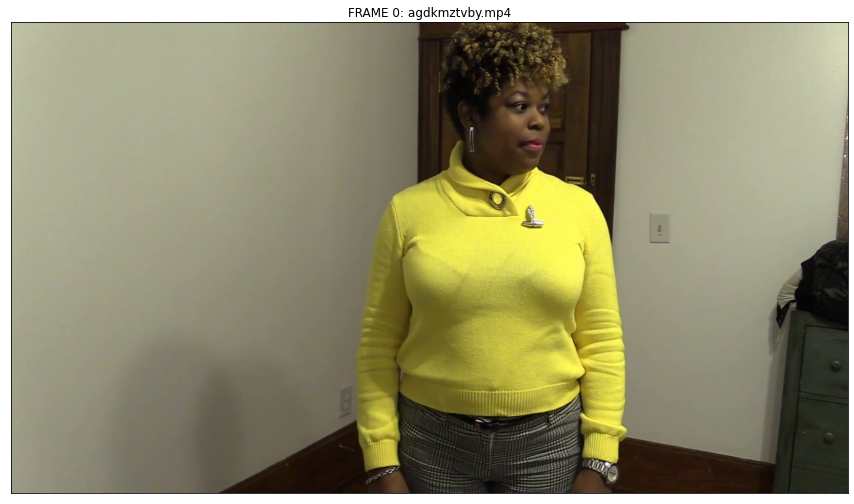

In [32]:
# this code snippet is taken from: https://www.kaggle.com/robikscube/kaggle-deepfake-detection-introduction#Can-you-detect-the-deepfake?
import cv2 as cv
import os
import matplotlib.pylab as plt
train_dir = '/kaggle/input/deepfake-detection-challenge/train_sample_videos/'
fig, ax = plt.subplots(1,1, figsize=(15, 15))
train_video_files = [train_dir + x for x in os.listdir(train_dir)]
# video_file = train_video_files[30]
video_file = '../input/deepfake-detection-challenge/train_sample_videos/agdkmztvby.mp4'
cap = cv.VideoCapture(video_file)
success, image = cap.read()
image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
cap.release()   
ax.imshow(image)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.title.set_text(f"FRAME 0: {video_file.split('/')[-1]}")
plt.grid(False)

# If you find this notebook helpful please upvote

Also, If there is any other kind of file that can be openned using python, please let me know.